## Content

- **Underfit Overfit Tradeoff**
    - Geometric Intuition
    - Mathematical Intuition
    - Relating with Bias Variance

- **Regularization**
    - L2 Regularization
    - L1 Regularization
    - Elastic net Regularization

- **Hyperparameter**
    - Hyperparameter tuning


# **Underfit Overfit Trade off**

### Geometric Intuition

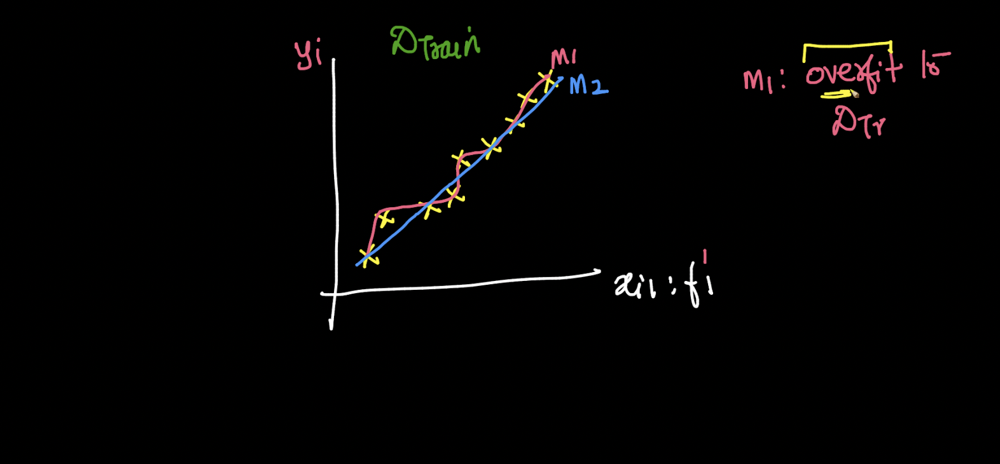

Assume we fitted two models to train data (single feature $f_1$)
- M1 (<font color = 'red'>complex</font>) - using higher degree polynomials
- M2 (<font color = 'blue'> simpler </font>) - using lower degree



We say model M1 has **overfit** to train data as 
- Data may contain noise and
- M1 is fitting to this noise as well. 


Overfitting means that our ML model is modeling (has learnt) the training data too well.


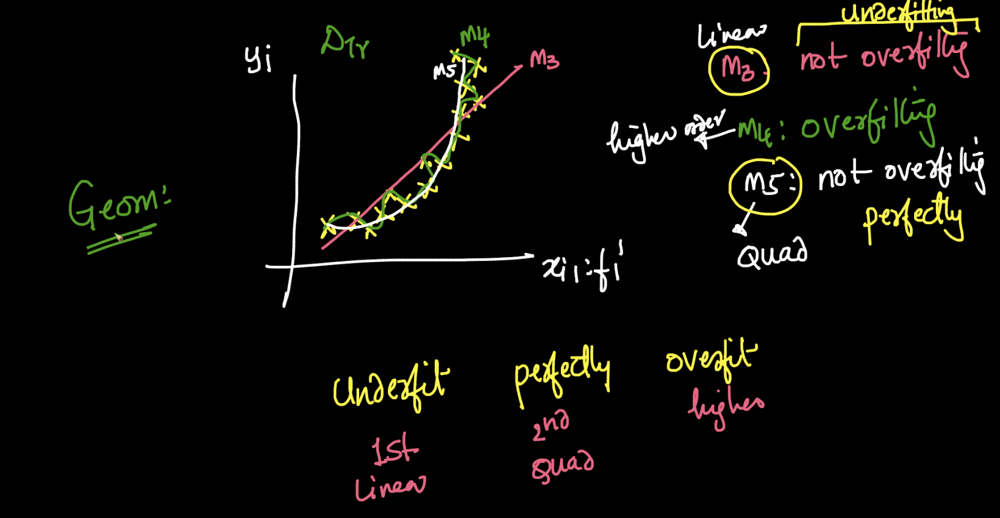

Assume another example with training data for single feature $f_1^1$

#### Is M3 (linear) overfitting to data?
No. 

#### Is M4 (higher order) overfitting to data?
Yes.

#### Is M5 (quadratic) fitting perfectly?
Yes. 


#### Now what are implications of underfitting?

**Underfitting** means that our ML **model can neither model the training data nor generalize to new unseen data**.

**An underfitted model will have poor(er) performance both on the training data and the testing data.**

Here, **M3 is underfitting.**



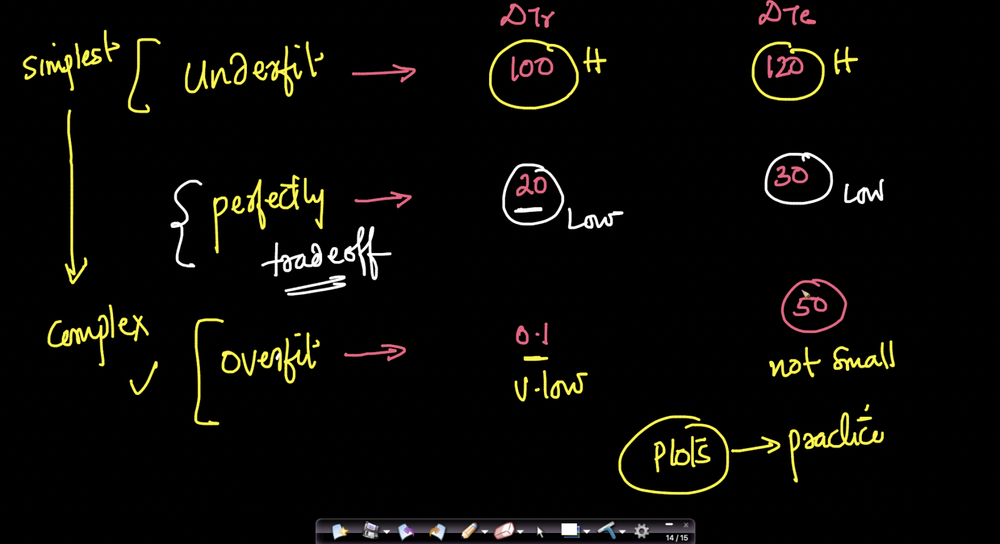

Now, We have 3 kinds of model
- Underfit
- Perfectly fit
- Overfit

#### How will each model behave in train test time ? 

- Underfit model ➡ Train error high, Test error high
- Overfit ➡ Train error very low, Test error high or not small
- Perfect fit model ➡ Both train and test error are low

# **Mathematical intuition**

#### How do we do trade off between underfitting overfitting, mathematically?

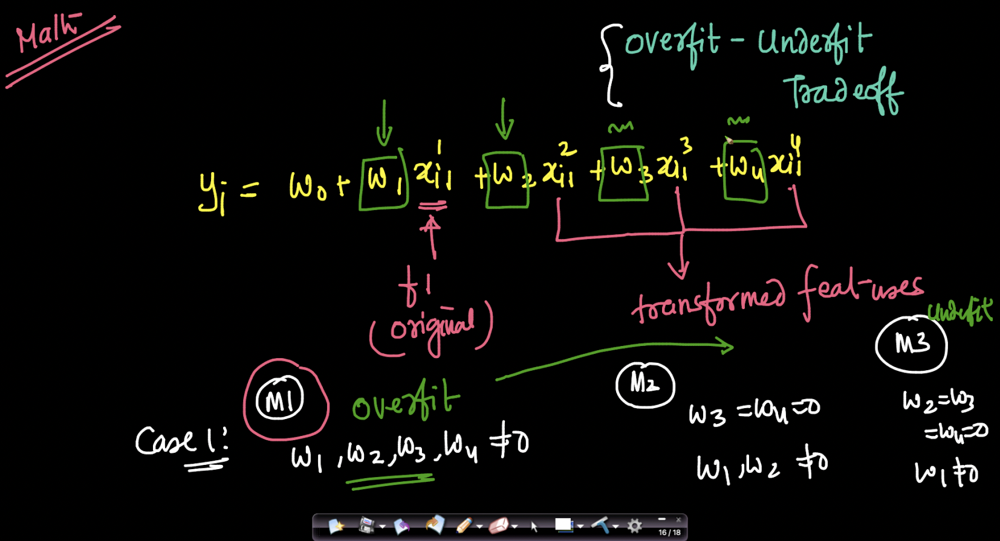

Consider the model function  

where $y_i = w_0 + w_1x_{i_1}^1 + w_2x_{i_1}^2 + w_3x_{i_1}^3 + w_4x_{i_1}^4$

- $f_1$ or $x_{i_1}$ is original feature
- Rest of features are transformed features (power of $f_1$)

We have 3 cases
- Case 1 (Model M1): $w_1, w_2, w_3, w_4 \neq 0 $
- Case 2 (Model M2): $w_1 , w_2 \neq 0$ and $w_3 = w_4 = 0$
- Case 3 (Model M3): $w_2 = w_3 = w_4 = 0$ and $w_1 \neq 0$


#### Question: Which of these is more likely to be overfit model? 
Model M1. 

Here, Critical concept is **weights**

- If weights are non zero ($w_1, w_2, w_3, w_4 \neq 0 $), it means we are giving some importance to $f_1, f_1^2, f_1^3 and  f_1^4$.

- Chances of having overfit model is more 

#### Question: Similarly, which of the the above model is underfitting ? 
Ans: Model M3


**If weights on higher order polynomial $\neq 0$, more chances of overfit**



# Relating with Bias Variance


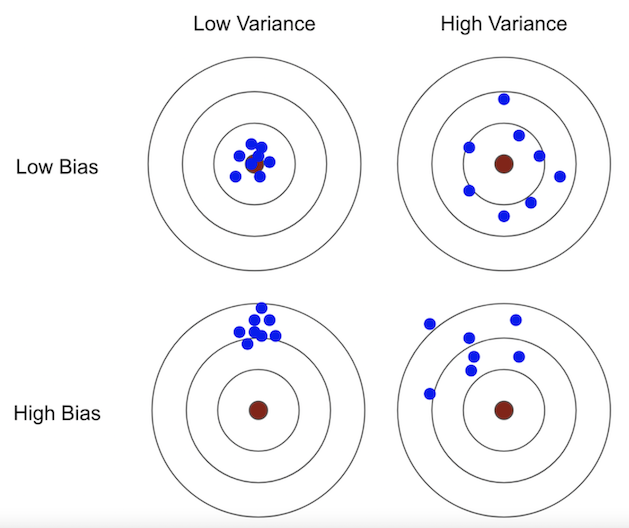

Let's try to understand with target shooting example:

**High bias is equivalent to aiming in the wrong place.** 

**High variance is equivalent to having an unsteady aim.**

This can lead to the following scenarios:

- Low bias, low variance: Aiming at the target and hitting it with good precision.
- Low bias, high variance: Aiming at the target, but not hitting it consistently.
- High bias, low variance: Aiming off the target, but being consistent.
- High bias, high variance: Aiming off the target and being inconsistent.

Ideally, a model trained using different sets of training set would give more or less similar results. If we change the dataset a bit, the model prediction should not be very different.

Now, given a model, 
- if you train it with different sets of training data (of same distribution)
- but the result are always systematically off from the truth value
- It is said to be **high bias model**
- Since the prediction are always consistent but off, both train and test data will be high.

Similarly, for a given model
- If you train it with different sets of training data
- and the predictions vary too much for each i.e. variance in prediction
- It is said to be **high variance** model
- High variance can be identified
    - Low training error (model is doing good on training data)
    - High test error (model sucks on unseen data)







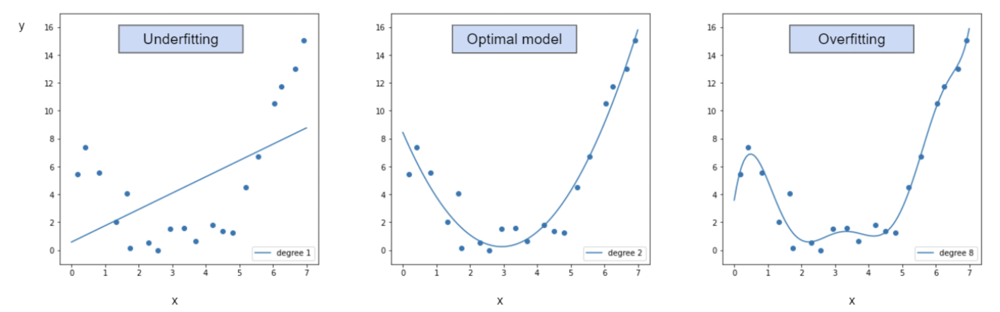

In machine learning terminology, 
- underfitting means that a model is too general, implying  high bias - low variance  (for example: fitting a line on quadratic data)

- while overfitting means that a model is too specific, implying  low bias - high variance. (for example: fitting higher order polynomial on quadratic data)

When training a model, it is important to balance these two. Since you can’t realistically avoid bias and variance altogether, this is called the bias-variance tradeoff.

# **Where is the sweet-spot?**

The sweet spot is defined as the point where the model’s performance on both the training set and the test (unseen) test set remain high.

#### How to choose the degree methodically? (How do we find the "sweet-spot")

Check which degree polynomial hypothesis performs best on test set and acceptably well on training set. 

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

degrees = 32 # number of data-points
train_scores = []
test_scores = []
for degree in range(1, degrees):
    polyreg_scaled = make_pipeline(PolynomialFeatures(degree), scaler, LinearRegression())
    polyreg_scaled.fit(X_train, y_train)
    train_score = polyreg_scaled.score(X_train, y_train)
    test_score = polyreg_scaled.score(X_test, y_test)
    train_scores.append(train_score)
    test_scores.append(test_score)

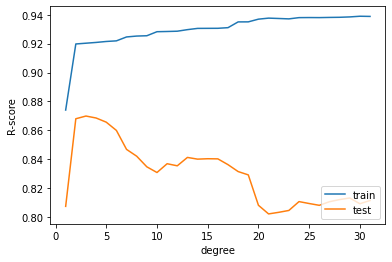

In [ ]:
plt.figure()
plt.plot(list(range(1, 32)), train_scores, label="train")
plt.plot(list(range(1, 32)), test_scores, label="test")
plt.legend(loc='lower right')
plt.xlabel("degree")
plt.ylabel("R-score")
plt.show()

# **Regularization**

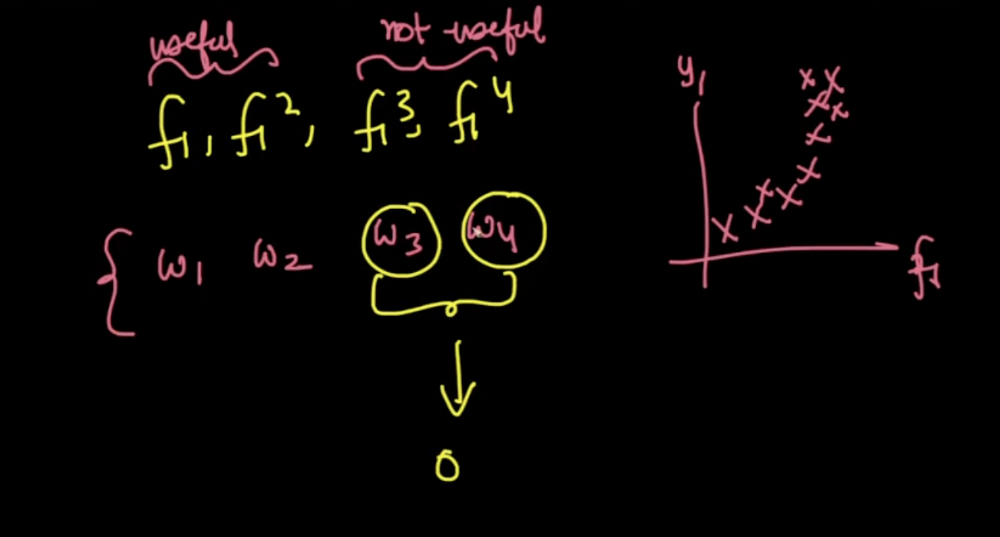

Imagine we have 
- data in shape of quadratic curve
- 4 features i.e. $f_1, f_1^2, f_1^3, f_1^4$

#### How to avoid overfitting ?

If we don't want to overfit, we should force $w_3, w_4$ to zero.


#### How to achieve it mathematically?

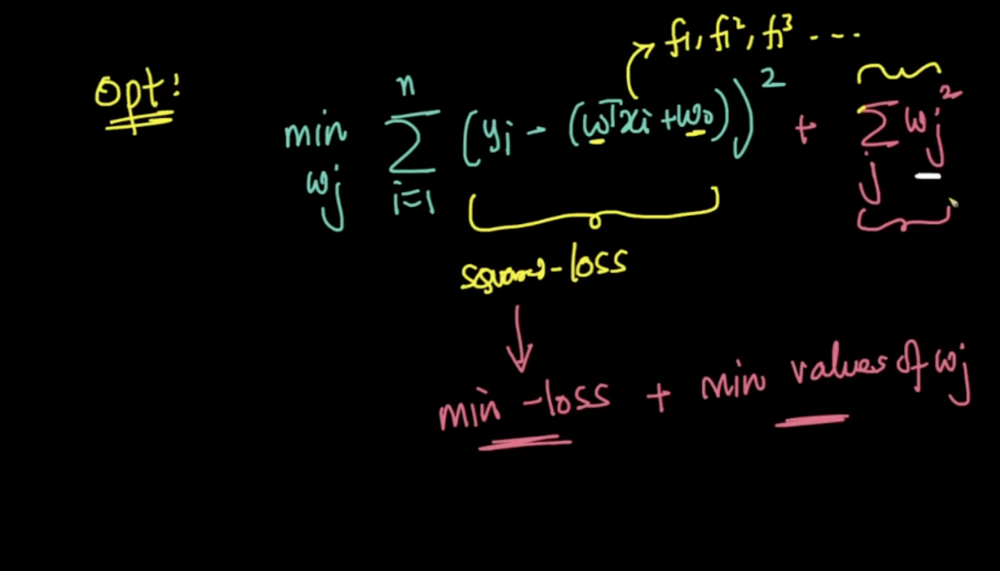

- We have an optmization equation which minimizes the squared loss
- We want some control over $w_j$'s so as to minimize weights of higher order features


#### **How can we achieve the control on weights?**
We add a term $\sum w_j^2$ to our optimization equation

Idea is:
- We don't $w_j$ values to be large for useless features.
- In addition ot mimimizing loss, minimize values of  $w_j$ as well

This is called as **regularization**

## **But, how do control the regularization ?**


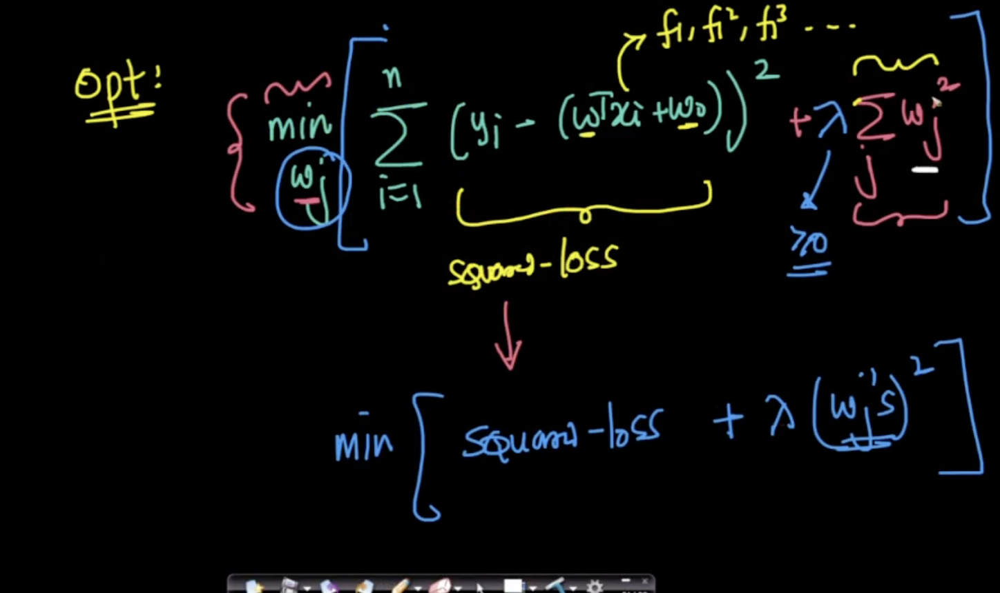

- We introduce a term $\lambda$ ($\geq 0$ ) which is multiplied with the regularization term ($\sum w_j^2$).
- The optimization equation becomes minimization of [squared loss and regularization term]




#### **How is regularization working?**

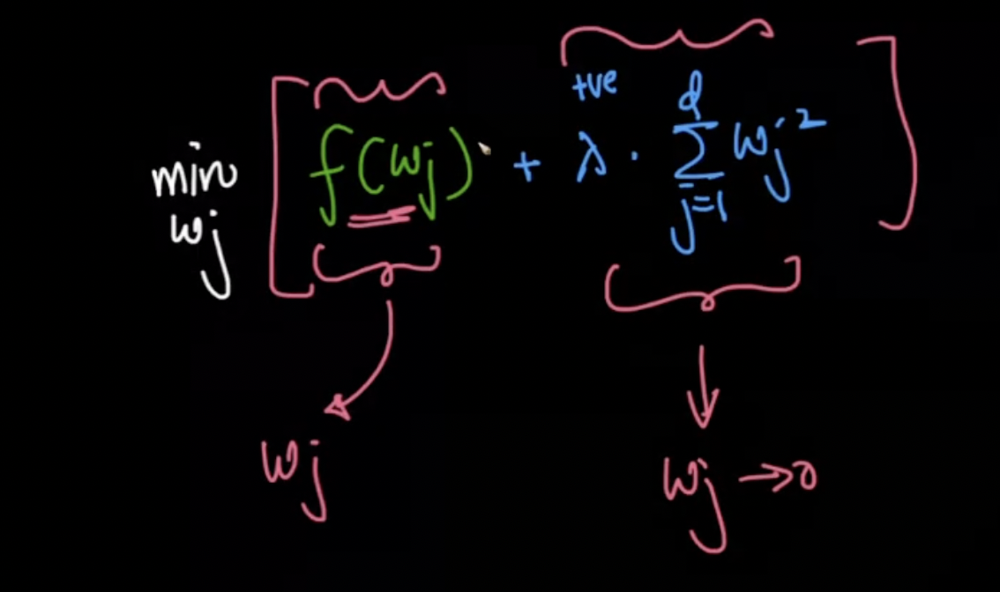

Now, we have two parts to optimization equation
  1. Loss term
  2. Regularization term

There is a tussle between the two parts
- Loss terms wants such $w_j$ which reduces the squared loss.
- Regularization term wants to reduce $w_j$ to 0.

At one point, it'll reach good tradeoff where it'll get $w_j$ which reduces the loss term and reduces $w_j$ to zero for useless features.

#### **Why does regularization only make useless feature zero?**

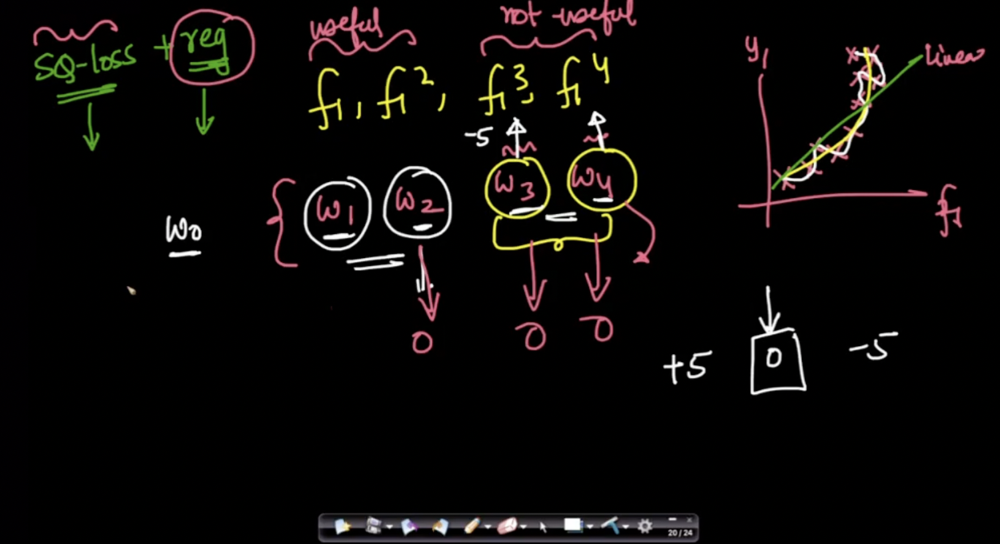

In order to minimize optimization equation, we need to minimize both
- squared loss
- regulariation term

Imagine a case where
- $w_2 = w_3 = w_4 = 0$

**What happens in this case?**
- The regularization term is happy as weights are tending to 0
- The loss term is unhappy as it is unable to fit data perfectly (only $w_1 \neq 0$, hence straight line) over quadratic data

Ther has to be balance or trade off between loss and regularization. You can't put too much pressure on one term.

If regularization makes useful feature ($f_1^2$ in this case) tend to 0
- Loss will increase
- Increase in loss term means it is not optimal solution anymore.




## **Why square of $w_j$ for regularization ?** 

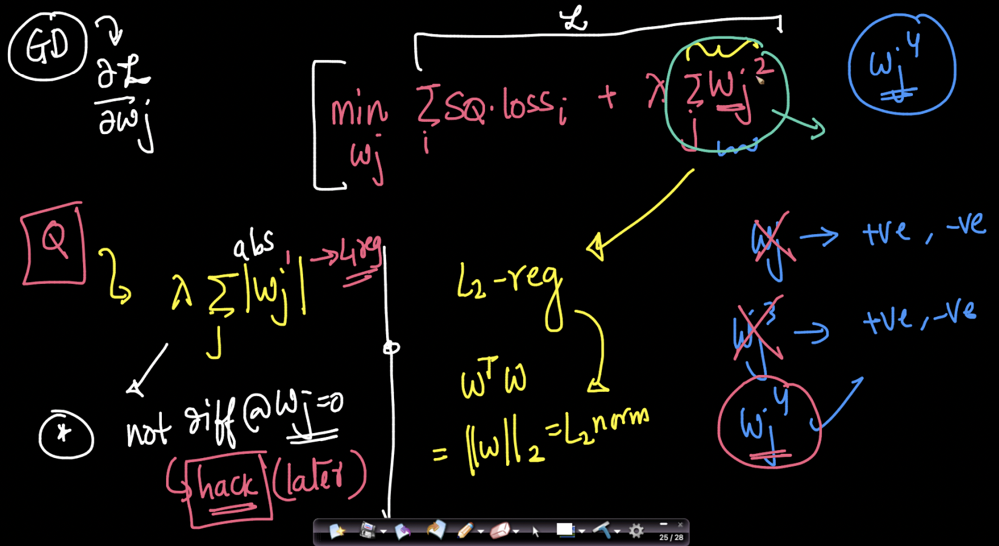

Regularization wants to reduce $w_j$ to 0 by still making the Loss function differentiable

If we take regularization term as 
- Case1: $w_j$
  - $w_j$ can be both +ve/-ve
  - This will encourage all $w_j$ to be -ve (to minimize the optimization equation)

- Case2: $w_j^3$
  - Cube term can be both +ve/-ve
  - Same issue as faced in Case1

- Case3: $w_j^4$
  - Can be used.

Here, $w_j^2$ is called **L2- regularization** or **Rigde regularization** or **Tekhonov regularization**



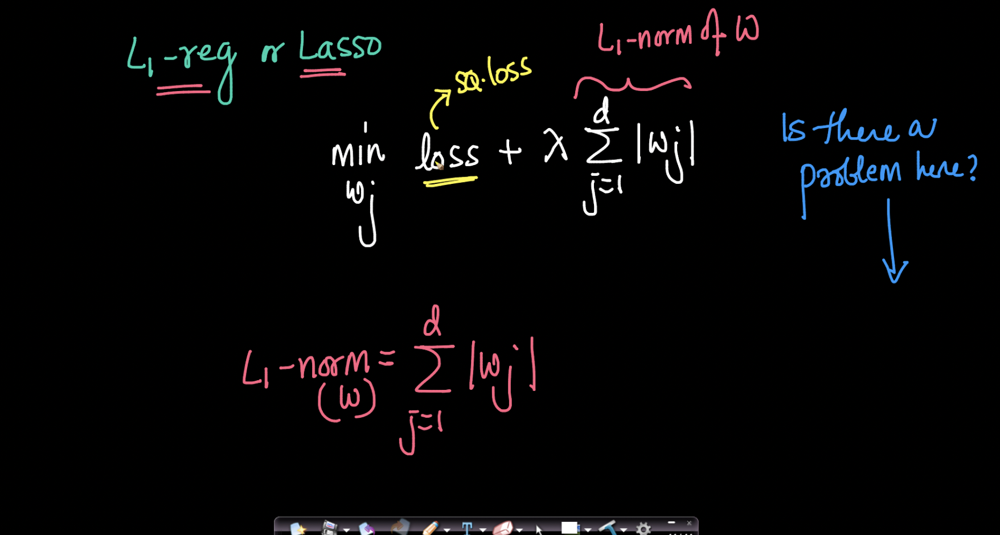

#### Question: What other functions of w can we use ? 

Ans: Absolute value of $w_j$ ($|w_j|$). It is also called **L1- regularization** or **Lasso regularization.**



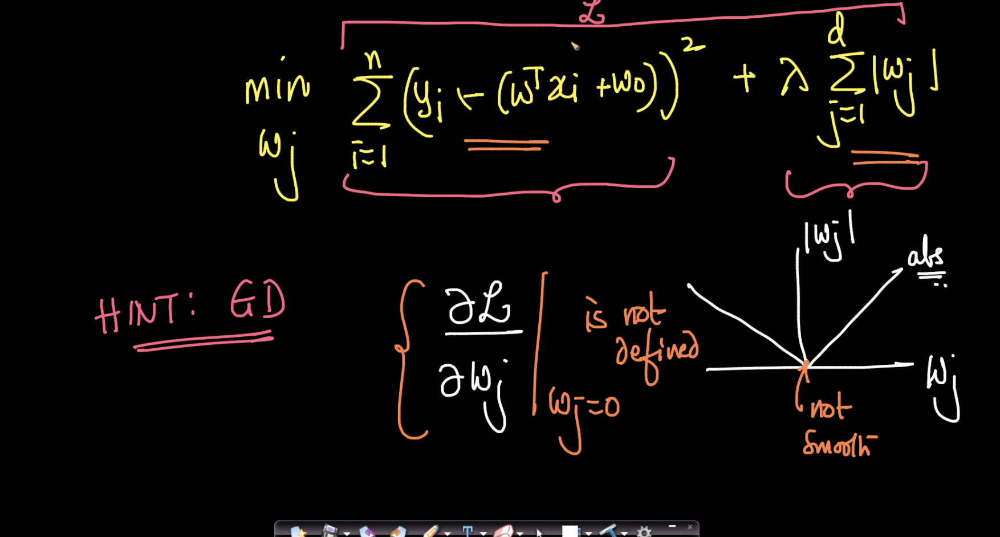

#### What is the issue with $|w_j|$ ?
- In optimization problem, we'll have to differentiate whole optimization equation w.r.t $w_j$. 

- $|w_j|$ is not differentiable at w = 0.



#### **How to fix it ?**

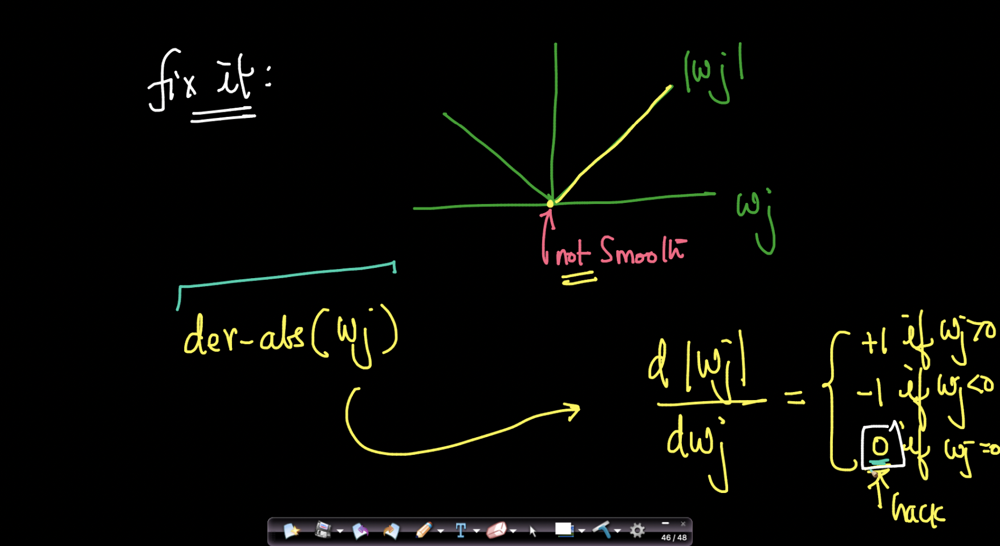

We use a small hack to compute the derivative
- Derivative $d |w_j|/ dw_j$ will be
  - +1 if $w_j > 0$
  - -1 if $w_j < 0$
  - <font color = 'red'> 0 if $w_j = 0$</font>

## **Why are we making derivative 0 when $w_j = 0$ ? (FAANG like interview question)**



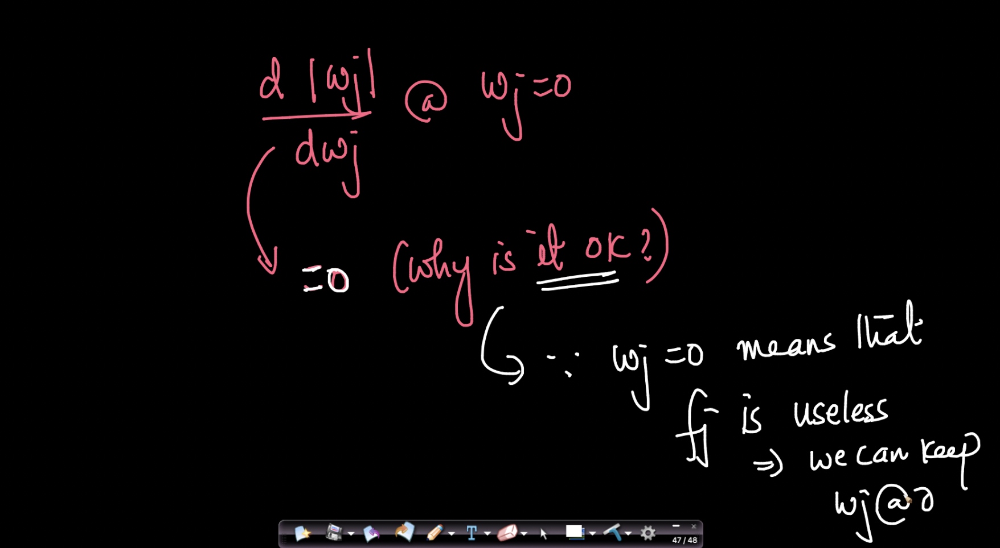

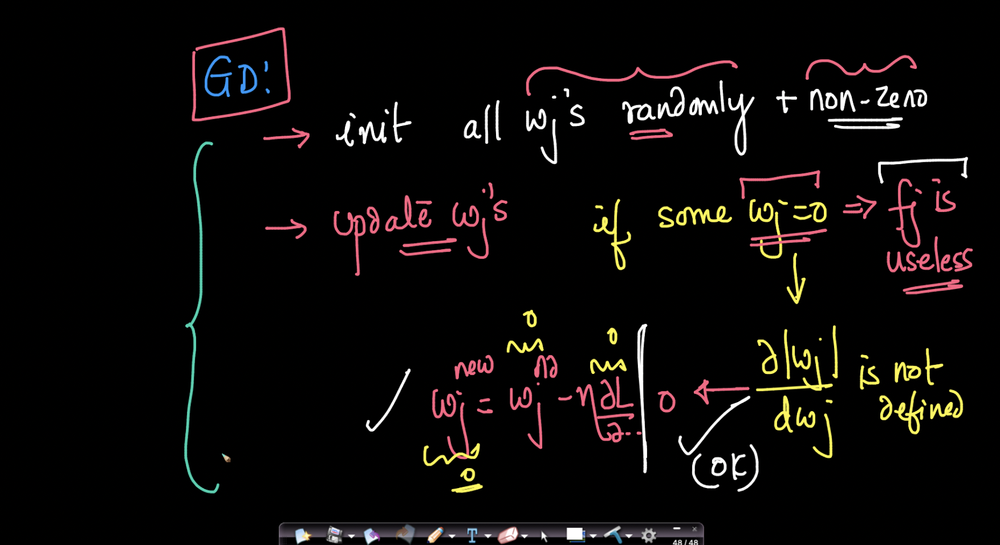

In Gradient Descent
- Initially, we initialize all $w_j$'s non zero randomly.
- then we update the $w_j$'s

Now, after update if $w_j = 0$, it means $f_j$ is useless.

If we define derivite = 0, it won't impact the update and hence it is fine.



## **Interesting property of L1- regularization**

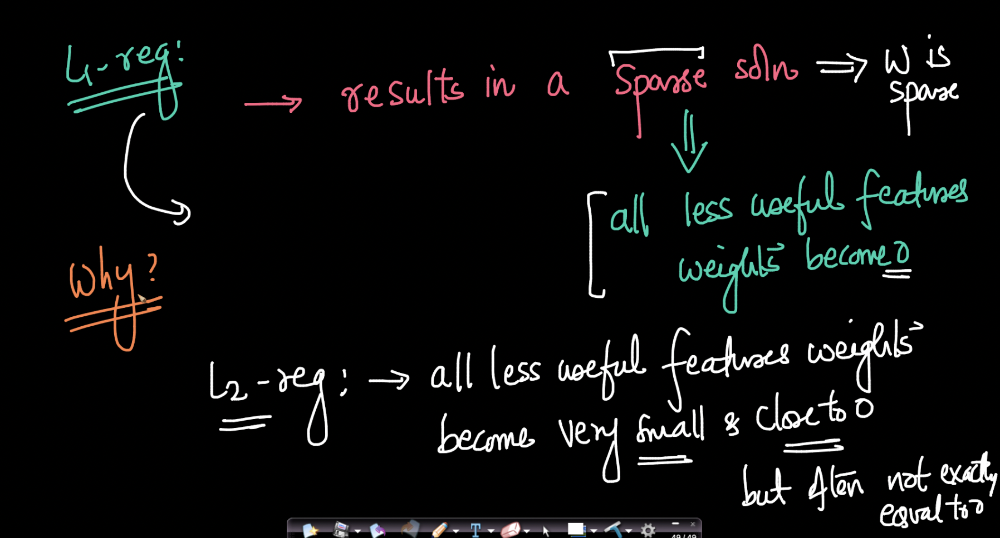

L1 regularization results in sparse solution

#### What does sparse solution mean? 

- It means that weight vector ($w$) will be sparse.
- All less useful / useless feature weights will be zero

However, in L2 regularization, all less useful feature weights become very small but often not exactly equal to 0.



#### **Why L1 regularization push useless feature weights to 0? (Geometric intuition)**

timstamp: Misc topics - 1 - 2:26:30

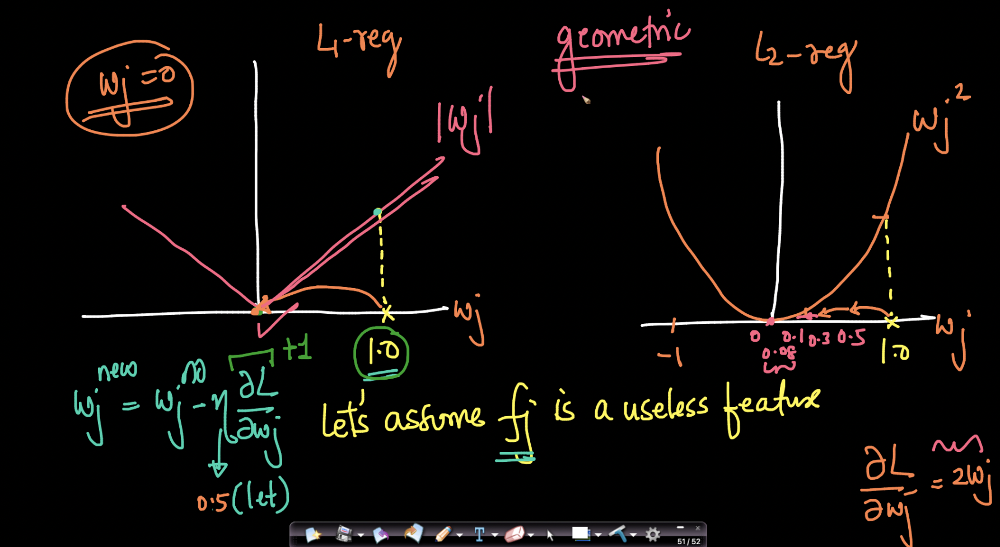

Optimization consists of 2 parts
- loss term
- regularization term

####Assumptions: 
- Let's assume $f_j$ is a useless feature such that $w_j$ for this feature is 1.0 

- Since, it is a useless feature, it won't contribute to loss term

- Assume the optimization equation has only regularization term (Ignore loss term for now)

#### What will be the gradients ? 

- Now, the gradient for L1 regularization ($|w_j|$) is +1 (as $w_j$ is positive) (independent of $w_j$)

- The gradient for L2 reg. is $2w_j$ (gradient is dependent on value of $w_j$)


#### What is the update equation? 

Update equation: $w_j^{new} = w_j^{old} - \eta . dL / dw_j$






Now, Let's assume $w_j = 0.9$ and learning rate,η = 0.2

**For update in L1 regularization**,
- $w_j^{new} = 0.9 - 0.2*1 = 0.7$

On 2nd Iteration
- $w_j^{new} = 0.7 - 0.2*1 = 0.5$

On 3rd Iteration
- $w_j^{new} = 0.5 - 0.2*1 = 0.3$
 
- After few iterations, $w_j^{new}$ will become zero
- constant value is being subtracted in each iteration (as gradient is a constant value)

But, **for update in L2**
- Since the value of gradient is dependent of $w_j$ (grad = $2w_j$)
- As the value of $w_j$ decreases, the value of gradient also decreases
- 1st iteration: $w_j^{new} = 0.9 - 0.2*2*0.9= 0.9 - 0.36 = 0.54$
- 2nd iteration: $w_j^{new} = 0.54 - 0.2*2*0.54 = 0.54 - 0.21 = 0.33$
- 3rd iteration: $w_j^{new} = 0.33 - 0.2*2*0.33 = 0.33 - 0.13 = 0.20$ 
- and so on...

**Notice that as $w_j$ approaches 0, the gradient keeps getting smaller (0.54, 0.33, 0.20) as it is function of $w_j$**

- Hence, in L2 regularization, as $w_j → 0$, gradient keeps getting smaller and $w_j$ never reaches 0.
- Unlike in L1, where a constant value is subtracted in each iteration irrespective of value of w.

## **Advantages and Disadvantages of L1 regularization**

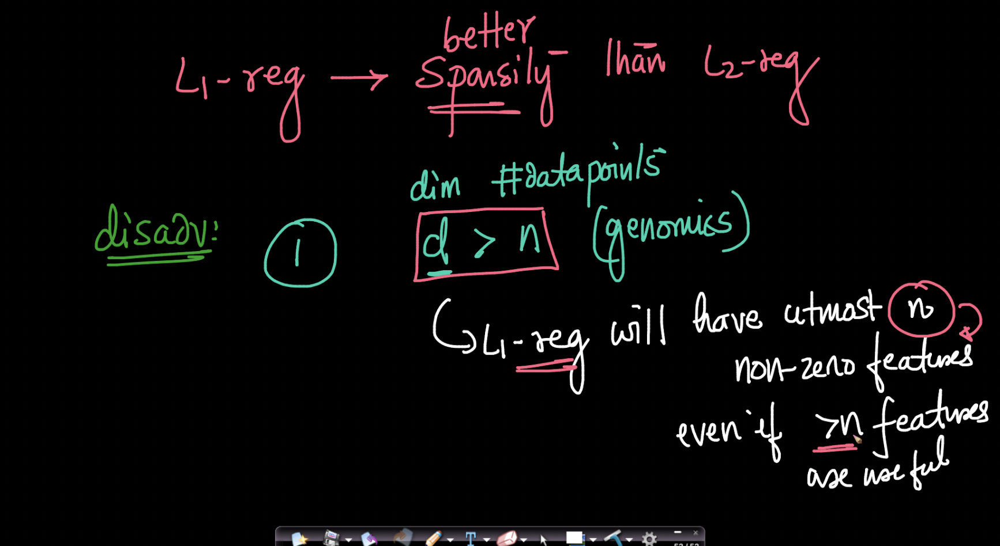

**Advantage**

We saw that **L1-reg. creates better sparsity than L2-regularization**

**Disadvantages**
1. Problem of saturation
    - If you have a dataset where number of dimensions is greater than number of datapoints (d>n) (Genemics - gene data)
    - L1 regularization will have utmost n non zero features even if > n features are useful
    - Proof. beyond the scope of class


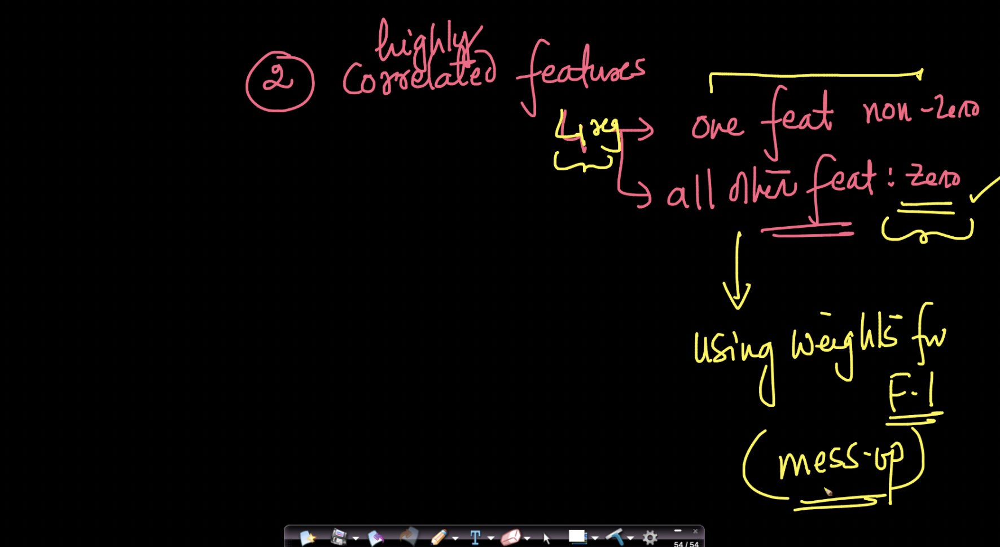

2. **Problem with correlation features**
    - If you have lot of highly correlated features
    - L1 regularization will make one feature as non zero
    - result all other features will become zero.
    - Which is correct in some cases but
    - Can mess up things when you are using weights for feature importance


### **How do we overcome these disadvantages? (Elastic net Regularization)**

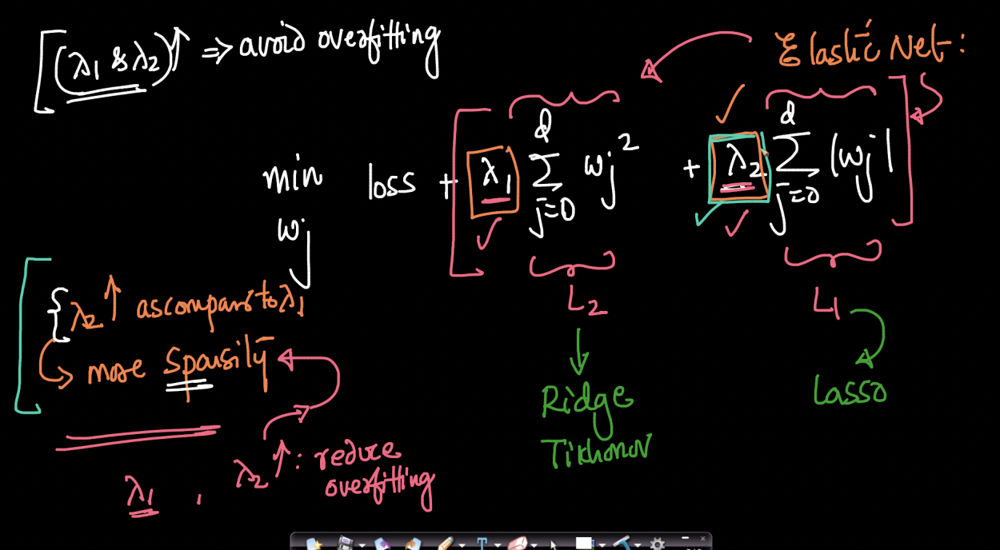

We use a combination of L1 and L2 regularization know as **Elastic Net Regularization**


- Since, we have both L2 and L1 regularization, it'll help in reducing overfitting as well as giving sparsity. 
- If $λ_2$ is more compared to $λ_1$, more sparsity.

# **Hyperparameter**

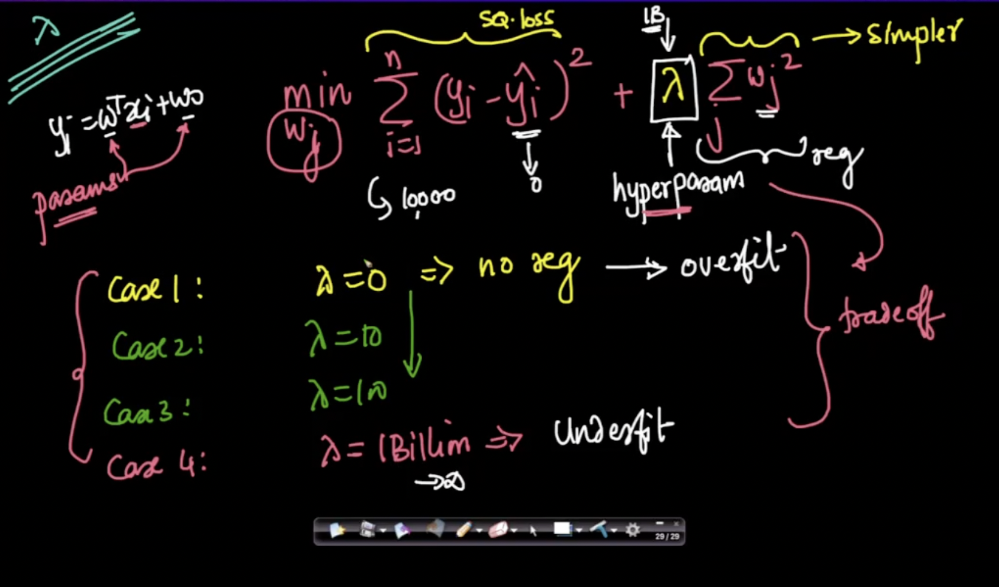

#### How does value of lambda impact the model?

Let's understand this with various cases

- Case1: $λ = 0$
  - There will be no regularization term. 
  - Model will overfit.

- Case2: $λ = ∞$ (large +ve value)
  - As value of lambda is large, the magnitude of squared loss term is negligible.
  - Weightage of regularization term will increase
  - It'll try to push all the $w_j$'s to zero.
  - Model will underfit.


Lambda, here is called **hyperparamter** of the model. 

Hyperparamters helps us do overfit- underfit tradeoff. By changing the lambda, we can control the regularization and hence overfit and underfit of the model.

As lambda increase, we tend from overfitting to underfitting. 

**Note:**
When we define a model, 
- the weights of the model becomes our parameters
- And the rest of the variables such as Regularization parameter becomes our Hyperparameter

#### Do we also optimize for λ? 



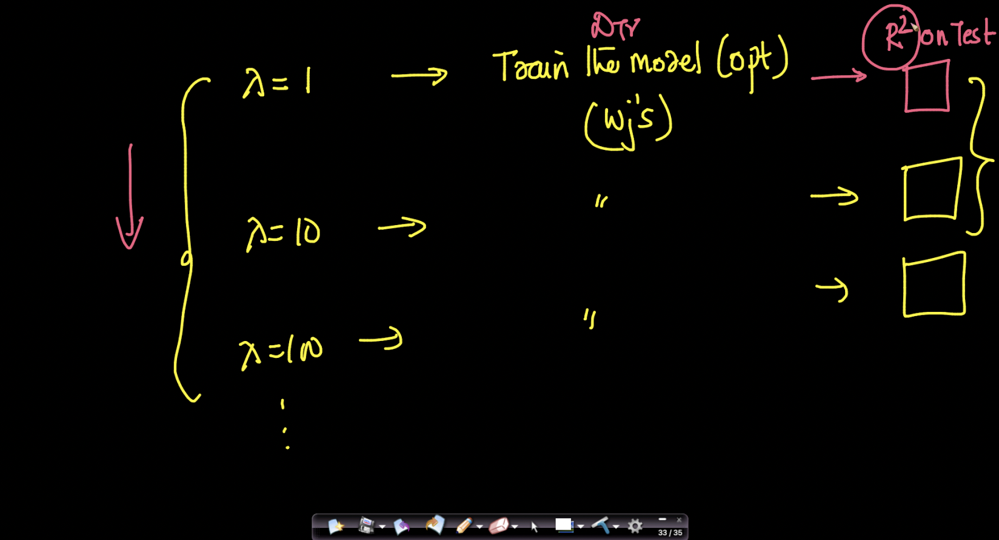

No. Purpose of λ is to control overfit underfit tradeoff.

In practice, 
- We fix λ to small value (say λ =1 ) and train the model
- We get model weights and find performance on test data
- Then, we increase the value of λ (say λ = 10) and train the model 
- We'll get different weights for new λ values and we find model performance on test set for new weights

**We try multiple value of lambda (λ) and pick the one which gives us lowest test error.**

It is the control level through which we can move from overfit to underfit manually and pick the model that's appropriate for us.


## **Question: Can we still use GD after adding regularization term?** 



Yes. We can take the derivative easily.

Similarly, we use the hack for L1-reg. (discussed earlier)

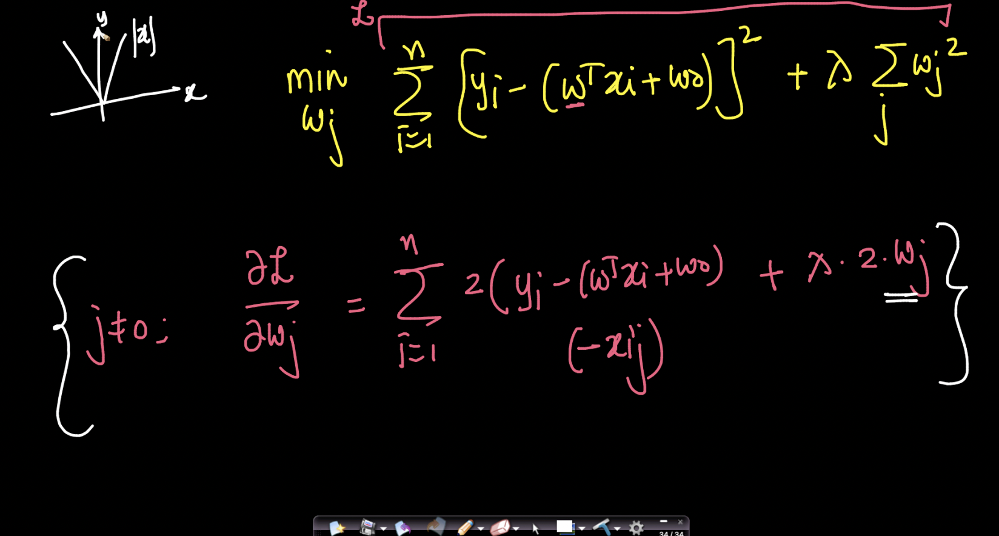

# **Hyperparameter tuning**


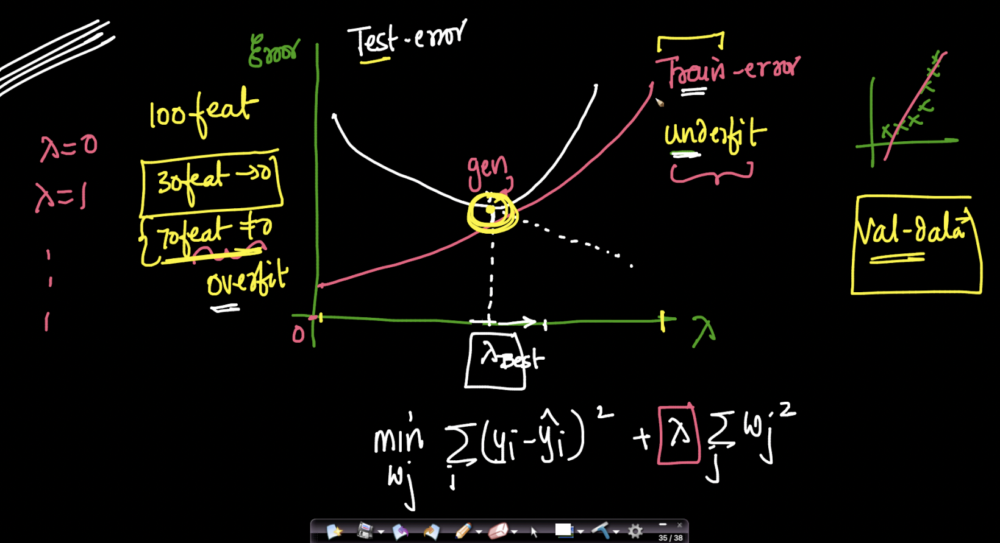

Let's draw a plot for **error vs lambda**

#### What will be the training error when lambda = 0 ? Minimum or maximum ? 

Training error will be minimum when lambda = 0.

As lambda = 0,
- There is no regularization term
- Model will overfit
- Training error will be minimum.

#### Will the training error increase or decrease as lambda increases?  

As we increase λ,
- model tends from overfit to underfit
- train error will gradually increase.


#### Now, what happens to test error when we are overfitting?

When model is overfitting, test error tends to be higher.

As we keep increasing λ, the test error will come down till $λ<sub>Tradeoff.

#### Will test error increase or decrease after λ_tradeoff ? 

As lambda increases, we are undefitting the model
- In underfitting
    - You data may be quadratic
    - but you'll be fitting linear function to it
    - test error will high

The test error will increase beyond λ tradeoff point.

**We take that lambda where the test error is minimum.** (λ<sub>Tradeoff</sub> = λ<sub>best</sub>)

- The model is neither overfitting nor underfitting at $λ_{best}$

- In practice
    - We keep changing the lambda
    - plot the train and test error
    - pick the lambda with mimimum test error.

This lambda will give us best generalized model.

And, the practice of trying multiple values of lambda to find best model is called **hyperparameter tuning**




